# Generative Adversarial Network (GAN)- Car Parking Lot Image Generation

                                                GROUP MEMBERS: 

                                                Kouma Semenya, 
                                                Lawrence Lassey 
                                                Lukmon Otunubi

# Brief description of the project

Generative adversarial networks (GANs) are algorithmic architectures that use two neural networks (Generator and Discriminator), pitting one against the other (thus the “adversarial”) in order to generate new, synthetic instances of data that can pass for real data. They are used widely in image generation, video generation and voice generation.

This project focuses on generation of a parking lot images under for three weather conditions i.e Cloudy, Rainy and Sunny. Due to the system requirement, the original images were resized to a lower resolution before training and the training was done over 4000 epochs. 

In the end, the generated images(fake) are more comparable to the real, lower resolution image with a perfect accuracy.


# Reference and Citation

References - https://github.com/SolClover/Art053_NN_DCGAN
           - https://towardsdatascience.com/deep-convolutional-gan-how-to-use-a-dcgan-to-generate-images-in-python-b08afd4d124e
           - https://github.com/SudharshanShanmugasundaram/Vanilla-GAN/blob/master/GAN.ipynb
           - https://github.com/safwankdb/Vanilla-GAN/blob/master/Vanilla_GAN.ipynb
           - https://wiki.pathmind.com/generative-adversarial-network-gan

### Import libraries

In [26]:
from tensorflow import keras 
from keras.models import Sequential 
from keras.layers import Dense, Reshape, Flatten, Conv2D, Conv2DTranspose, ReLU, LeakyReLU, Dropout 
from tensorflow.keras.utils import plot_model 
from tensorflow.keras.optimizers import Adam 
import numpy as np 
import sklearn
from sklearn.preprocessing import MinMaxScaler 
import cv2 
import matplotlib 
import matplotlib.pyplot as plt 
import graphviz 
import random
import sys
import os
main_dir=os.path.dirname(sys.path[0])


## Preparing the training data.
- Source and Licence: http://web.inf.ufpr.br/vri/databases/parking-lot-database/

In [49]:
def extract_packing_lot_images():
    print("Extracting images, Please wait.....")
    path_to_file = []
    x_train = []
    sub_path = ["Cloudy","Rainy","Sunny"]
    base_name = r"PKLot\PKLot\UFPR04"
    for filename in os.listdir(base_name):
        path_to_file.append(os.path.join(base_name,filename))

    paths = []
    for path in path_to_file:
        for name in os.listdir(path):
            paths.append(os.path.join(path,name))

    #Final path
    count  = 0
    number_of_folder = len(paths)
    for index,path in enumerate(paths):
        for image in os.listdir(path):
            if image.endswith("jpg"):
                img_array = cv2.imread(os.path.join(path,image))
                #img_array = cv2.cvtColor(img_array, cv2.COLOR_BGR2GRAY)
                img_array= cv2.resize(img_array,(128,128))
                x_train.append(img_array)
        if ((index+1) % 10 == 0 or index + 1 == number_of_folder):
            print(f"{round((index+1)*100/number_of_folder,2)} % of the images extracted")

    images = np.array(x_train)/255.0
    print("")
    print(f"{images.shape[0]} images extracted")
    return images

In [28]:
data_lowres = extract_packing_lot_images()

Extracting images, Please wait.....
20.41 % of the images extracted
40.82 % of the images extracted
61.22 % of the images extracted
81.63 % of the images extracted
100.0 % of the images extracted

3791 images extracted


In [29]:
_,height,width,length = data_lowres.shape

##### Display a few real images of lower resolution (128 x 128 pixels)

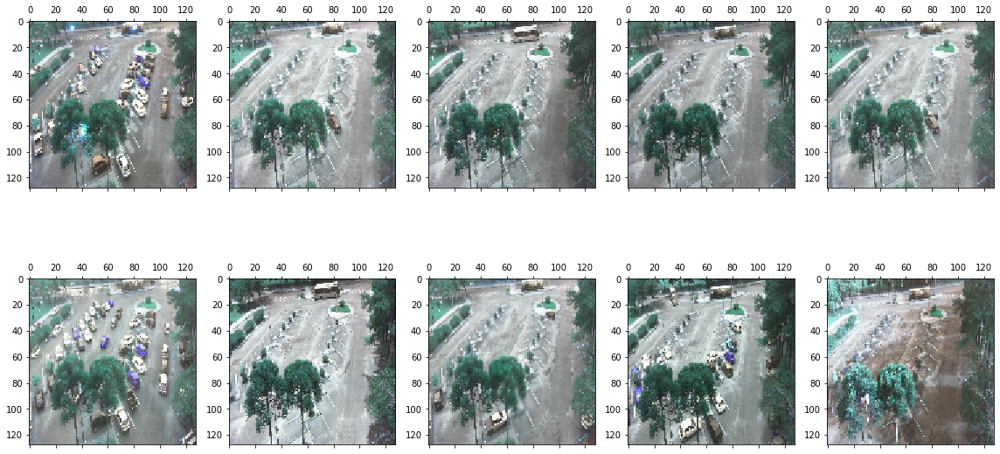

In [30]:
# Display 10 random real images
fig, axs = plt.subplots(2, 5, sharey=False, tight_layout=True, figsize=(16,9), facecolor='white')

for i in range(0,2):
    for j in range(0,5):
        n = random.randint(0,1000)
        axs[i,j].matshow(data_lowres[n])
        n=n+1
plt.show() 

In [31]:
# Scaler
scaler=MinMaxScaler(feature_range=(-1, 1))

# Select images that we want to use for model trainng
data=data_lowres.copy()
print("Original shape of the data: ", data.shape)

# Reshape array
data=data.reshape(-1, 1)
print("Reshaped data: ", data.shape)

# Fit the scaler
scaler.fit(data)

# Scale the array
data=scaler.transform(data)

# Reshape back to the original shape
data=data.reshape(data_lowres.shape[0], height, width, length)
print("Shape of the scaled array: ", data.shape)

Original shape of the data:  (3791, 128, 128, 3)
Reshaped data:  (186335232, 1)
Shape of the scaled array:  (3791, 128, 128, 3)


## Implementing Generative Adversarial Network(GAN).

#### Define Generator model

In [32]:
def generator(latent_dim):
    model = Sequential(name="Generator") # Model
    
    # Hidden Layer 1: Start with 8 x 8 image
    n_nodes = 8 * 8 * 128 # number of nodes in the first hidden layer
    model.add(Dense(n_nodes, input_dim=latent_dim, name='Generator-Hidden-Layer-1'))
    model.add(Reshape((8, 8, 128), name='Generator-Hidden-Layer-Reshape-1'))
    
    # Hidden Layer 2: Upsample to 16 x 16
    model.add(Conv2DTranspose(filters=128, kernel_size=(4,4), strides=(2,2), padding='same', name='Generator-Hidden-Layer-2'))
    model.add(ReLU(name='Generator-Hidden-Layer-Activation-2'))
                              
    # Hidden Layer 3: Upsample to 32 x 32
    model.add(Conv2DTranspose(filters=256, kernel_size=(4,4), strides=(2,2), padding='same', name='Generator-Hidden-Layer-3'))
    model.add(ReLU(name='Generator-Hidden-Layer-Activation-3'))
    
    # Hidden Layer 4: Upsample to 64 x 64
    model.add(Conv2DTranspose(filters=512, kernel_size=(4,4), strides=(2,2), padding='same', name='Generator-Hidden-Layer-4'))
    model.add(ReLU(name='Generator-Hidden-Layer-Activation-4'))
    
    # Hidden Layer 4: Upsample to 128 x 128
    model.add(Conv2DTranspose(filters=1024, kernel_size=(4,4), strides=(2,2), padding='same', name='Generator-Hidden-Layer-5'))
    model.add(ReLU(name='Generator-Hidden-Layer-Activation-5'))
    
  
    
    # Output Layer 
    model.add(Conv2D(filters=3, kernel_size=(5,5), activation='tanh', padding='same', name='Generator-Output-Layer'))
    return model

# Instantiate
latent_dim=100 # Our latent space has 100 dimensions. We can change it to any number
gen_model = generator(latent_dim)

# Show model summary and plot model diagram
gen_model.summary()
#plot_model(gen_model, show_shapes=True, show_layer_names=True, dpi=400) #, to_file='generator_structure.png')

Model: "Generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Generator-Hidden-Layer-1 (D  (None, 8192)             827392    
 ense)                                                           
                                                                 
 Generator-Hidden-Layer-Resh  (None, 8, 8, 128)        0         
 ape-1 (Reshape)                                                 
                                                                 
 Generator-Hidden-Layer-2 (C  (None, 16, 16, 128)      262272    
 onv2DTranspose)                                                 
                                                                 
 Generator-Hidden-Layer-Acti  (None, 16, 16, 128)      0         
 vation-2 (ReLU)                                                 
                                                                 
 Generator-Hidden-Layer-3 (C  (None, 32, 32, 256)      52

#### Define a Discriminator model

In [33]:
def discriminator(in_shape=(height,width,length)):
    model = Sequential(name="Discriminator") # Model
    
    # Hidden Layer 1
    model.add(Conv2D(filters=64, kernel_size=(4,4), strides=(2, 2), padding='same', input_shape=in_shape, name='Discriminator-Hidden-Layer-1'))
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-1'))
    
    # Hidden Layer 2
    model.add(Conv2D(filters=128, kernel_size=(4,4), strides=(2, 2), padding='same', input_shape=in_shape, name='Discriminator-Hidden-Layer-2'))
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-2'))
    
    # Hidden Layer 3
    model.add(Conv2D(filters=128, kernel_size=(4,4), strides=(2, 2), padding='same', input_shape=in_shape, name='Discriminator-Hidden-Layer-3'))
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-3'))
    
    # Flatten and Output Layers
    model.add(Flatten(name='Discriminator-Flatten-Layer'))
    model.add(Dropout(0.3, name='Discriminator-Flatten-Layer-Dropout')) 
    model.add(Dense(1, activation='sigmoid', name='Discriminator-Output-Layer')) 
    
    # Compile the model
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])
    return model

# Instantiate
dis_model = discriminator()

# Show model summary
dis_model.summary()

Model: "Discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Discriminator-Hidden-Layer-  (None, 64, 64, 64)       3136      
 1 (Conv2D)                                                      
                                                                 
 Discriminator-Hidden-Layer-  (None, 64, 64, 64)       0         
 Activation-1 (LeakyReLU)                                        
                                                                 
 Discriminator-Hidden-Layer-  (None, 32, 32, 128)      131200    
 2 (Conv2D)                                                      
                                                                 
 Discriminator-Hidden-Layer-  (None, 32, 32, 128)      0         
 Activation-2 (LeakyReLU)                                        
                                                                 
 Discriminator-Hidden-Layer-  (None, 16, 16, 128)    

#### Combine Generator and Discriminator models into trainable GAN

In [51]:
def def_gan(generator, discriminator):
    
    discriminator.trainable = False
    
    model = Sequential(name="GAN") 
    model.add(generator) 
    model.add(discriminator)
    
    
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5))
    return model


gan_model = def_gan(gen_model, dis_model)


gan_model.summary()


Model: "GAN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Generator (Sequential)      (None, 128, 128, 3)       12178307  
                                                                 
 Discriminator (Sequential)  (None, 1)                 429377    
                                                                 
Total params: 12,607,684
Trainable params: 12,178,307
Non-trainable params: 429,377
_________________________________________________________________


##### Set up a function to sample real images

In [35]:
def real_samples(n, dataset):
    
    # Samples of real data
    X = dataset[np.random.choice(dataset.shape[0], n, replace=True), :]

    # Class labels
    y = np.ones((n, 1))

    return X, y

##### Generate points in the latent space, which we will use as inputs for the generator

In [36]:
def latent_vector(latent_dim, n):
    
    # Generate points in the latent space
    latent_input = np.random.randn(latent_dim * n)
    
    # Reshape into a batch of inputs for the network
    latent_input = latent_input.reshape(n, latent_dim)
    return latent_input

##### The below function will use the generator to generate n fake images together with class label 0

In [37]:
def fake_samples(generator, latent_dim, n):
    
    # Generate points in latent space
    latent_output = latent_vector(latent_dim, n)
    
    # Predict outputs (i.e., generate fake samples)
    X = generator.predict(latent_output)
    
    # Create class labels
    y = np.zeros((n, 1))
    return X, y

### Setup functions for model performance evaluation and training

##### Show Discriminator model accuracy and plot real vs. fake (generated) comparison

In [38]:
def performance_summary(generator, discriminator, dataset, latent_dim, n=50):
    
    # Get samples of the real data
    x_real, y_real = real_samples(n, dataset)
    # Evaluate the descriminator on real data
    _, real_accuracy = discriminator.evaluate(x_real, y_real, verbose=0)
    
    # Get fake (generated) samples
    x_fake, y_fake = fake_samples(generator, latent_dim, n)
    # Evaluate the descriminator on fake (generated) data
    _, fake_accuracy = discriminator.evaluate(x_fake, y_fake, verbose=0)
    
    # summarize discriminator performance
    print("*** Evaluation ***")
    print("Discriminator Accuracy on REAL images: ", real_accuracy)
    print("Discriminator Accuracy on FAKE (generated) images: ", fake_accuracy)
    
    # Create a 2D scatter plot to show real and fake (generated) data points
    # Display 6 fake images
    x_fake_inv_trans=x_fake.reshape(-1, 1)
    x_fake_inv_trans=scaler.inverse_transform(x_fake_inv_trans)
    x_fake_inv_trans=x_fake_inv_trans.reshape(n, height, width, length)
    
    fig, axs = plt.subplots(2, 3, sharey=False, tight_layout=True, figsize=(12,6), facecolor='white')
    k=0
    for i in range(0,2):
        for j in range(0,3):
            axs[i,j].matshow(x_fake_inv_trans[k])
            k=k+1
    plt.show() 

##### Define a function to train our GAN model (generator and discriminator)

In [39]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=1001, n_batch=32, n_eval=100):
    
    # Our batch to train the discriminator will consist of half real images and half fake (generated) images
    half_batch = int(n_batch / 2)
    
    # We will manually enumare epochs 
    for i in range(n_epochs):
    
    # Discriminator training
        # Prep real samples
        x_real, y_real = real_samples(half_batch, dataset)
        # Prep fake (generated) samples
        x_fake, y_fake = fake_samples(g_model, latent_dim, half_batch)
        
        # Train the discriminator using real and fake samples
        X, y = np.vstack((x_real, x_fake)), np.vstack((y_real, y_fake))
        discriminator_loss, _ = d_model.train_on_batch(X, y)
    
    # Generator training
        # Get values from the latent space to be used as inputs for the generator
        x_gan = latent_vector(latent_dim, n_batch)
        # While we are generating fake samples, 
        # we want GAN generator model to create examples that resemble the real ones,
        # hence we want to pass labels corresponding to real samples, i.e. y=1, not 0.
        y_gan = np.ones((n_batch, 1))
        
        # Train the generator via a composite GAN model
        generator_loss = gan_model.train_on_batch(x_gan, y_gan)
        
        # Evaluate the model at every n_eval epochs
        if (i) % n_eval == 0:
            print("Epoch number: ", i)
            print("*** Training ***")
            print("Discriminator Loss ", discriminator_loss)
            print("Generator Loss: ", generator_loss)
            performance_summary(g_model, d_model, dataset, latent_dim)

## Training the GAN model over 4000 Epochs

1/1 [==============================] - 6s 6s/step
Epoch number:  0
*** Training ***
Discriminator Loss  0.6979628205299377
Generator Loss:  0.6926844716072083
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


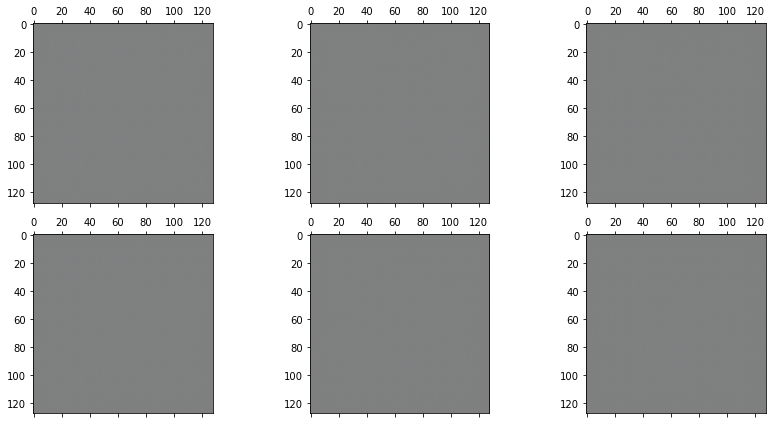

1/1 [==============================] - 5s 5s/step
Epoch number:  100
*** Training ***
Discriminator Loss  0.33330807089805603
Generator Loss:  1.482147216796875
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.41999998688697815


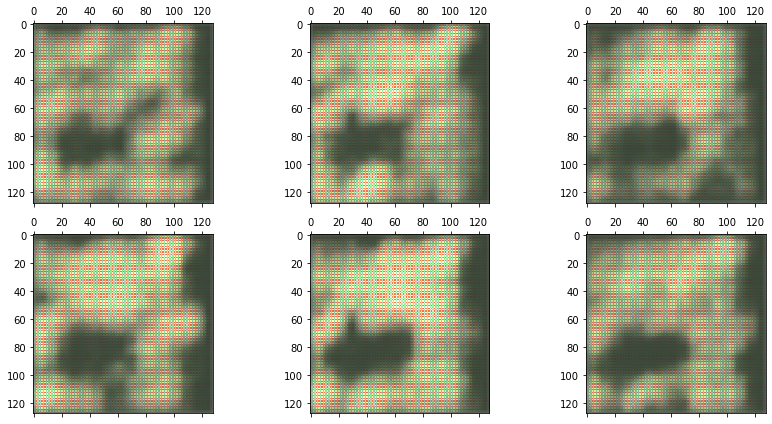

1/1 [==============================] - 5s 5s/step
Epoch number:  200
*** Training ***
Discriminator Loss  0.3437567353248596
Generator Loss:  1.6633415222167969
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8999999761581421
Discriminator Accuracy on FAKE (generated) images:  1.0


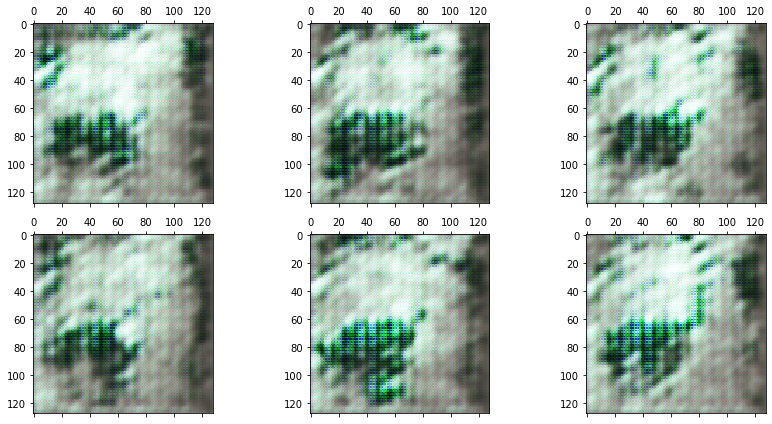

1/1 [==============================] - 5s 5s/step
Epoch number:  300
*** Training ***
Discriminator Loss  0.2136681079864502
Generator Loss:  1.6630616188049316
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.9800000190734863
Discriminator Accuracy on FAKE (generated) images:  0.7400000095367432


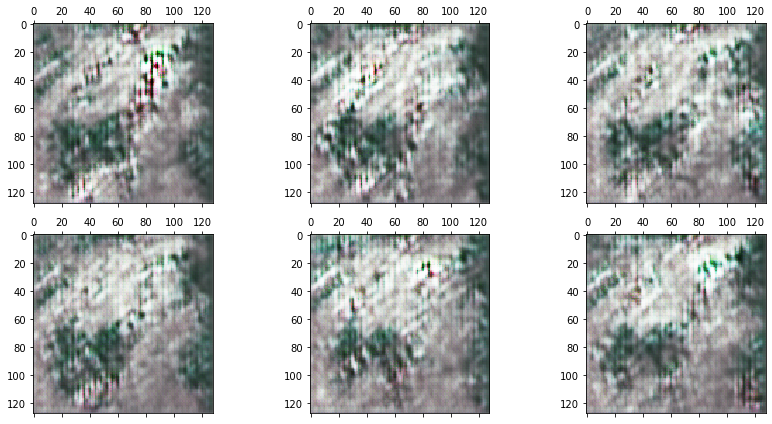

1/1 [==============================] - 5s 5s/step
Epoch number:  400
*** Training ***
Discriminator Loss  0.4895922839641571
Generator Loss:  1.6093566417694092
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8199999928474426
Discriminator Accuracy on FAKE (generated) images:  0.9800000190734863


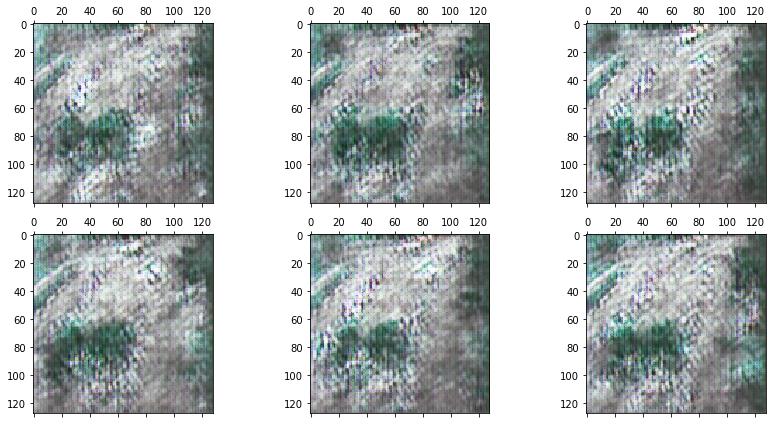

1/1 [==============================] - 5s 5s/step
Epoch number:  500
*** Training ***
Discriminator Loss  0.3108804225921631
Generator Loss:  2.4385275840759277
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8199999928474426
Discriminator Accuracy on FAKE (generated) images:  1.0


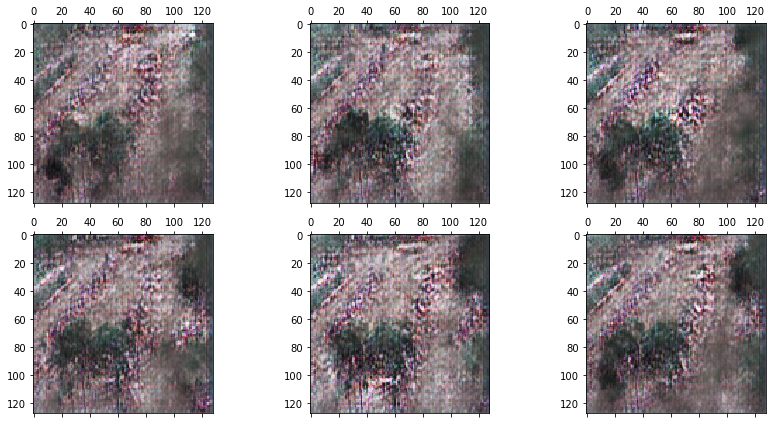

1/1 [==============================] - 5s 5s/step
Epoch number:  600
*** Training ***
Discriminator Loss  0.41155755519866943
Generator Loss:  1.9812976121902466
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5400000214576721
Discriminator Accuracy on FAKE (generated) images:  1.0


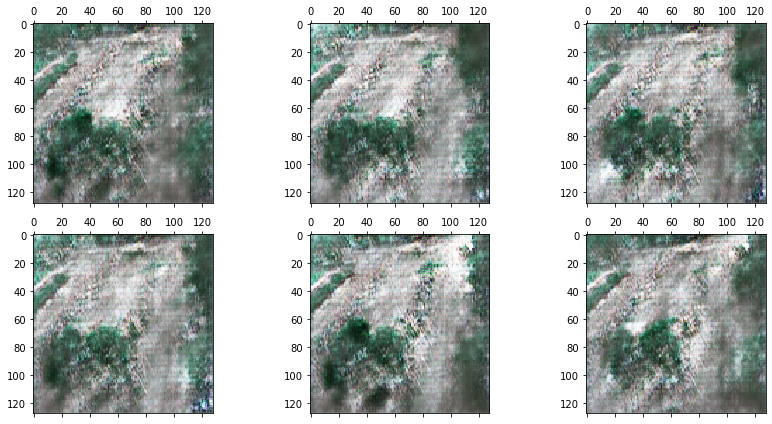

1/1 [==============================] - 5s 5s/step
Epoch number:  700
*** Training ***
Discriminator Loss  0.5079399347305298
Generator Loss:  1.43230402469635
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6600000262260437
Discriminator Accuracy on FAKE (generated) images:  1.0


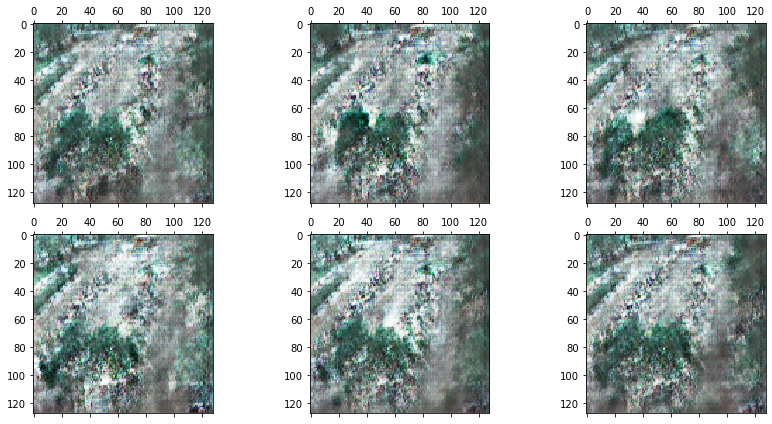

1/1 [==============================] - 6s 6s/step
Epoch number:  800
*** Training ***
Discriminator Loss  0.29406610131263733
Generator Loss:  1.9770914316177368
2/2 [==============================] - 20s 7s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8399999737739563
Discriminator Accuracy on FAKE (generated) images:  0.14000000059604645


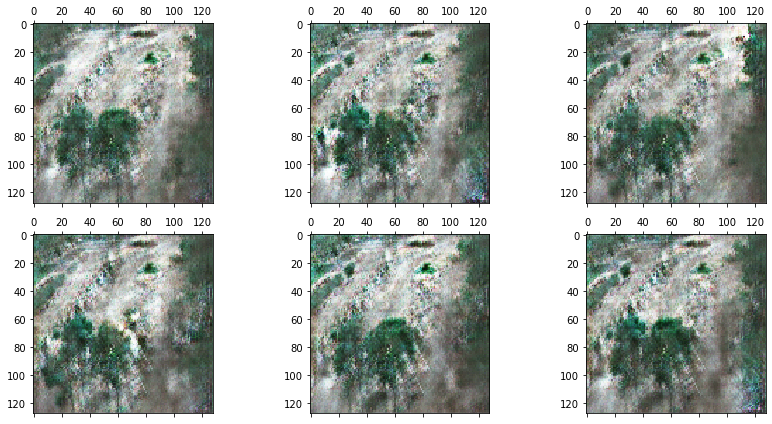

1/1 [==============================] - 5s 5s/step
Epoch number:  900
*** Training ***
Discriminator Loss  0.3989546298980713
Generator Loss:  2.051988124847412
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5400000214576721
Discriminator Accuracy on FAKE (generated) images:  0.9599999785423279


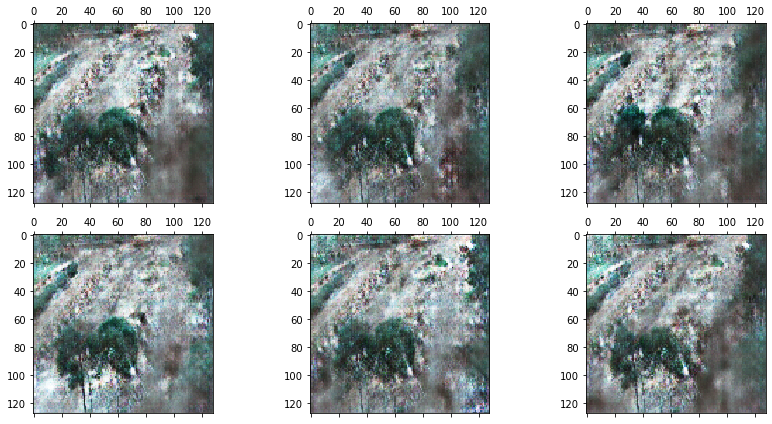

1/1 [==============================] - 5s 5s/step
Epoch number:  1000
*** Training ***
Discriminator Loss  0.5772430896759033
Generator Loss:  1.499000906944275
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6800000071525574
Discriminator Accuracy on FAKE (generated) images:  0.7599999904632568


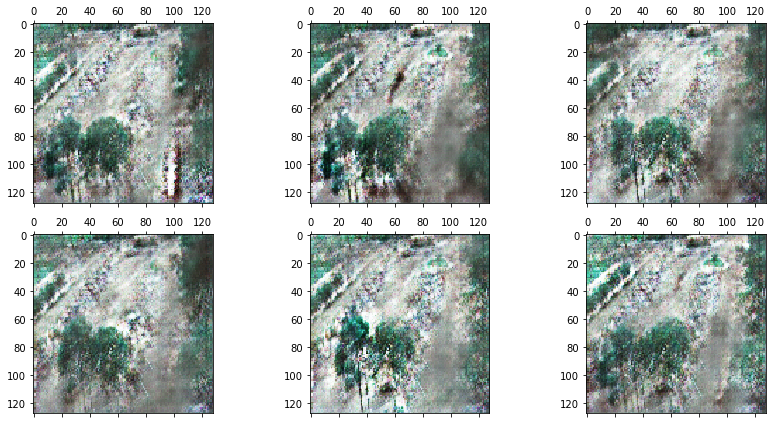

In [40]:
# 1k epochs
train(gen_model, dis_model, gan_model, data, latent_dim)

1/1 [==============================] - 5s 5s/step
Epoch number:  0
*** Training ***
Discriminator Loss  0.4516950845718384
Generator Loss:  1.2356423139572144
2/2 [==============================] - 14s 5s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.800000011920929
Discriminator Accuracy on FAKE (generated) images:  0.6000000238418579


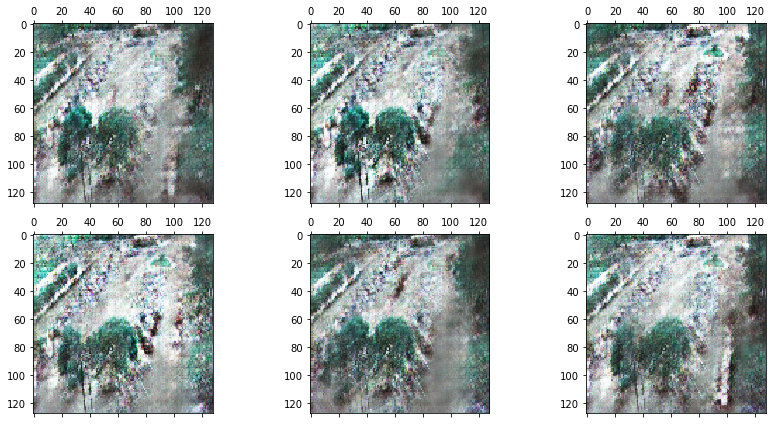

1/1 [==============================] - 5s 5s/step
Epoch number:  100
*** Training ***
Discriminator Loss  0.6477833986282349
Generator Loss:  1.0086565017700195
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8999999761581421
Discriminator Accuracy on FAKE (generated) images:  0.41999998688697815


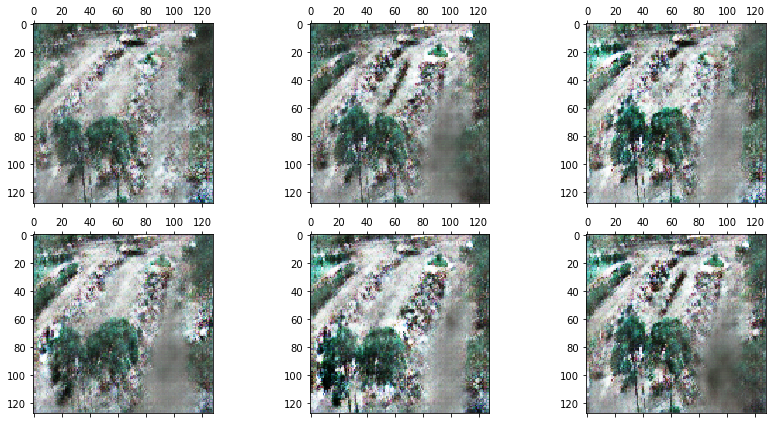

1/1 [==============================] - 5s 5s/step
Epoch number:  200
*** Training ***
Discriminator Loss  0.5883100032806396
Generator Loss:  1.1153430938720703
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8999999761581421
Discriminator Accuracy on FAKE (generated) images:  0.1599999964237213


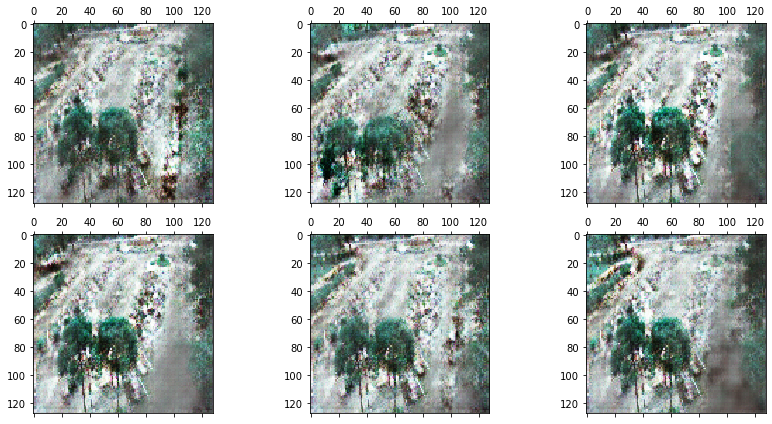

1/1 [==============================] - 5s 5s/step
Epoch number:  300
*** Training ***
Discriminator Loss  0.5421558618545532
Generator Loss:  1.1038917303085327
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8600000143051147
Discriminator Accuracy on FAKE (generated) images:  0.47999998927116394


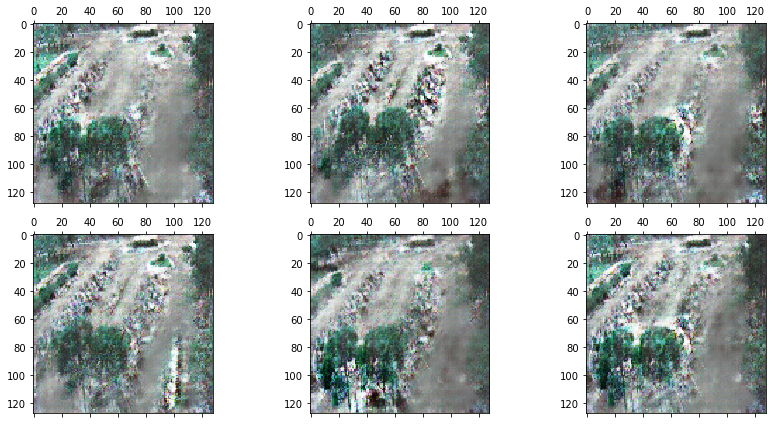

1/1 [==============================] - 5s 5s/step
Epoch number:  400
*** Training ***
Discriminator Loss  0.7074548006057739
Generator Loss:  1.0823384523391724
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.699999988079071
Discriminator Accuracy on FAKE (generated) images:  0.5799999833106995


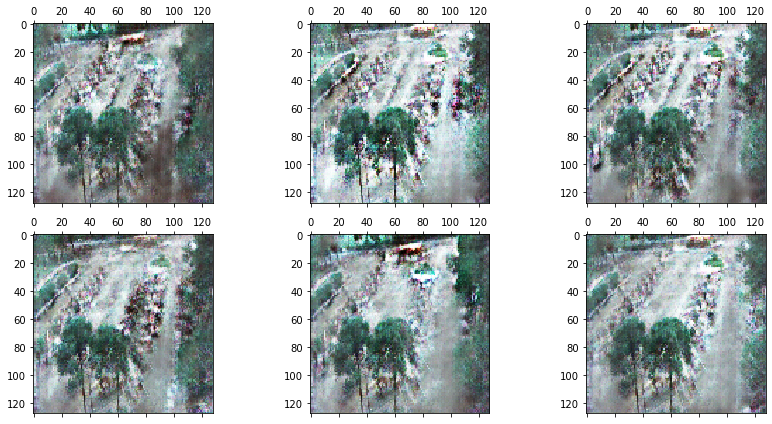

1/1 [==============================] - 5s 5s/step
Epoch number:  500
*** Training ***
Discriminator Loss  0.620036244392395
Generator Loss:  1.3592619895935059
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5400000214576721
Discriminator Accuracy on FAKE (generated) images:  0.9200000166893005


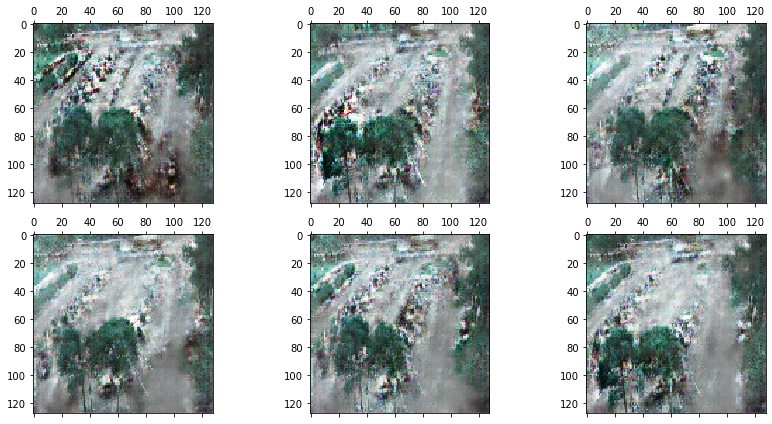

1/1 [==============================] - 5s 5s/step
Epoch number:  600
*** Training ***
Discriminator Loss  0.6311296224594116
Generator Loss:  0.9492830634117126
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8399999737739563
Discriminator Accuracy on FAKE (generated) images:  0.36000001430511475


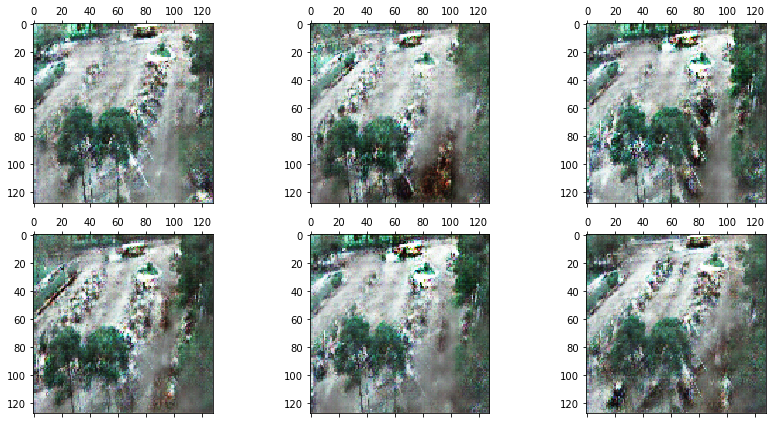

1/1 [==============================] - 5s 5s/step
Epoch number:  700
*** Training ***
Discriminator Loss  0.6356964111328125
Generator Loss:  1.1592260599136353
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6800000071525574
Discriminator Accuracy on FAKE (generated) images:  0.7400000095367432


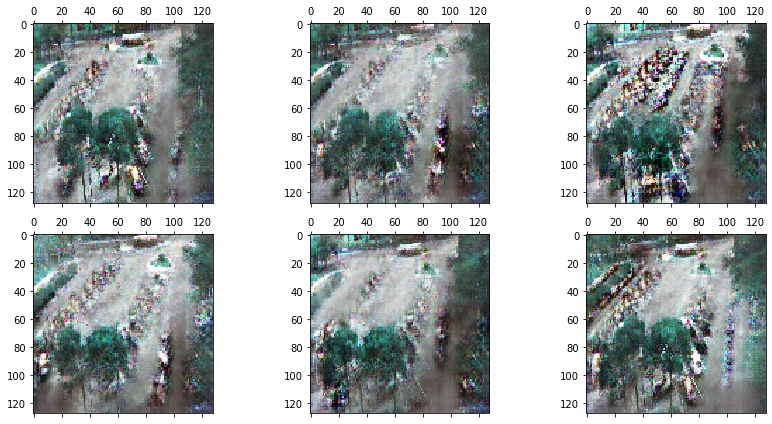

1/1 [==============================] - 5s 5s/step
Epoch number:  800
*** Training ***
Discriminator Loss  0.6915303468704224
Generator Loss:  1.232291340827942
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6000000238418579
Discriminator Accuracy on FAKE (generated) images:  0.8199999928474426


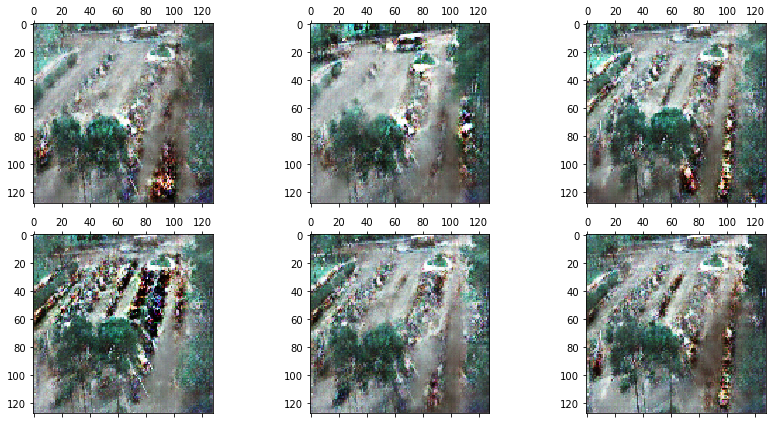

1/1 [==============================] - 5s 5s/step
Epoch number:  900
*** Training ***
Discriminator Loss  0.5912788510322571
Generator Loss:  1.1590527296066284
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5400000214576721
Discriminator Accuracy on FAKE (generated) images:  0.9599999785423279


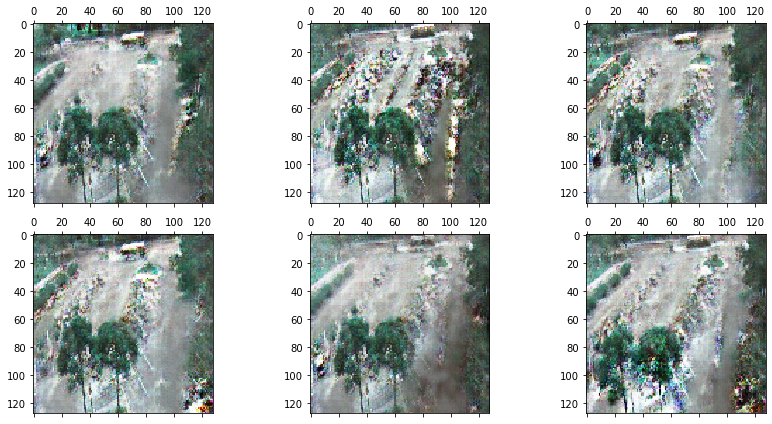

1/1 [==============================] - 5s 5s/step
Epoch number:  1000
*** Training ***
Discriminator Loss  0.593562126159668
Generator Loss:  1.3955802917480469
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5799999833106995
Discriminator Accuracy on FAKE (generated) images:  0.9200000166893005


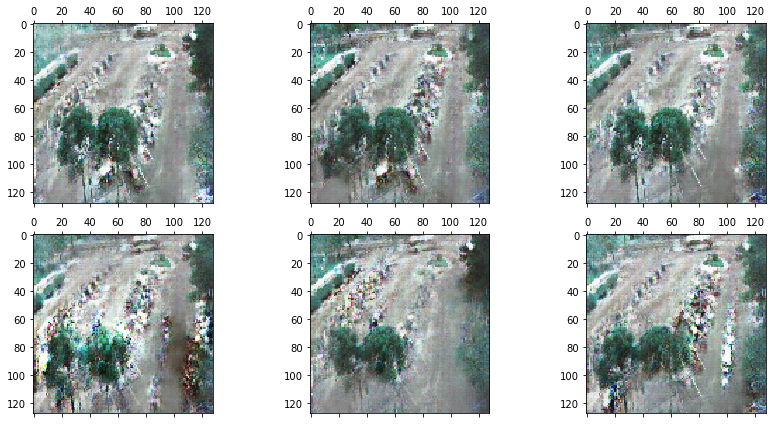

In [41]:
# Continue training the model for another 1000 epochs (Total: 2K epochs)
train(gen_model, dis_model, gan_model, data, latent_dim)

1/1 [==============================] - 5s 5s/step
Epoch number:  0
*** Training ***
Discriminator Loss  0.6203514337539673
Generator Loss:  1.0971640348434448
2/2 [==============================] - 15s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.800000011920929
Discriminator Accuracy on FAKE (generated) images:  0.7400000095367432


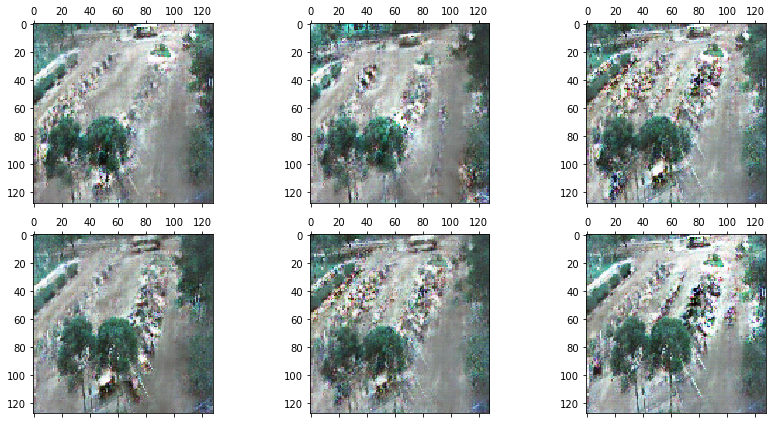

1/1 [==============================] - 5s 5s/step
Epoch number:  100
*** Training ***
Discriminator Loss  0.5472593903541565
Generator Loss:  1.6073927879333496
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6600000262260437
Discriminator Accuracy on FAKE (generated) images:  0.5


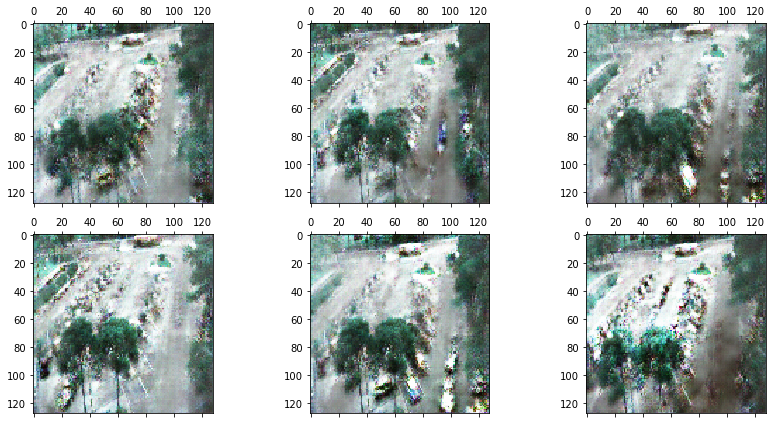

1/1 [==============================] - 5s 5s/step
Epoch number:  200
*** Training ***
Discriminator Loss  0.5441904067993164
Generator Loss:  1.203452706336975
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.7200000286102295
Discriminator Accuracy on FAKE (generated) images:  0.7599999904632568


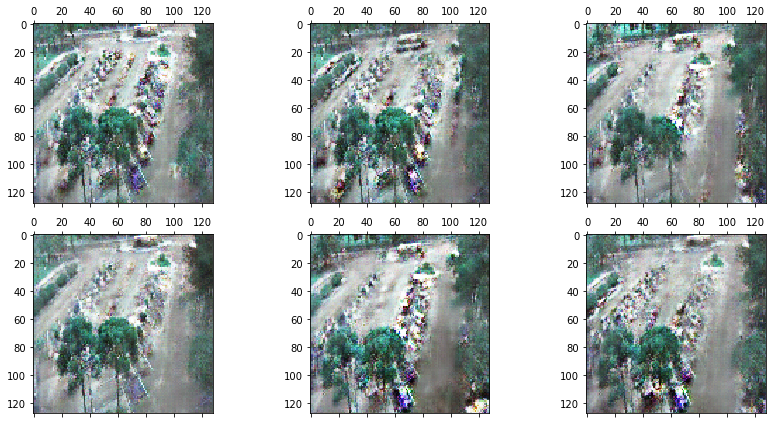

1/1 [==============================] - 5s 5s/step
Epoch number:  300
*** Training ***
Discriminator Loss  0.6346201300621033
Generator Loss:  1.208012580871582
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.699999988079071
Discriminator Accuracy on FAKE (generated) images:  0.7200000286102295


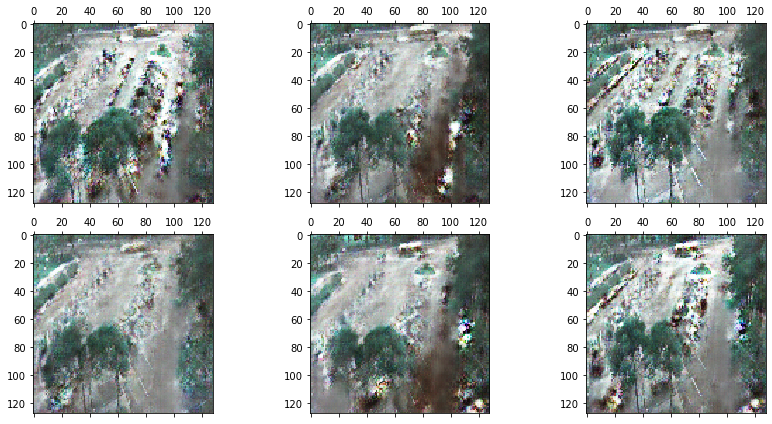

1/1 [==============================] - 5s 5s/step
Epoch number:  400
*** Training ***
Discriminator Loss  0.5397289991378784
Generator Loss:  1.604917287826538
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6200000047683716
Discriminator Accuracy on FAKE (generated) images:  0.6399999856948853


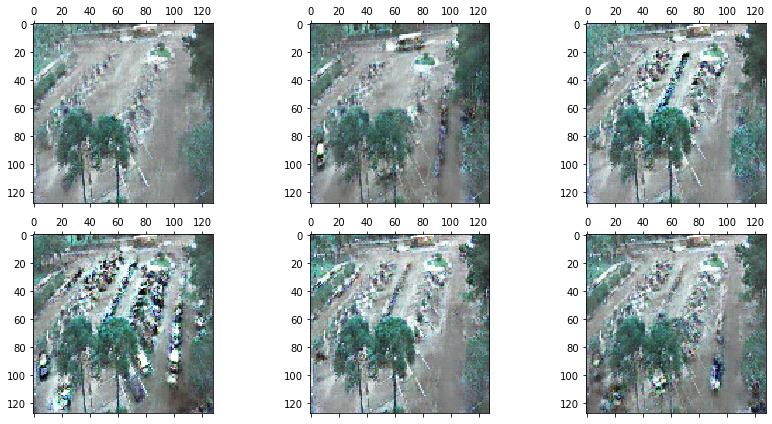

1/1 [==============================] - 5s 5s/step
Epoch number:  500
*** Training ***
Discriminator Loss  0.6844091415405273
Generator Loss:  1.1253252029418945
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6200000047683716
Discriminator Accuracy on FAKE (generated) images:  0.5199999809265137


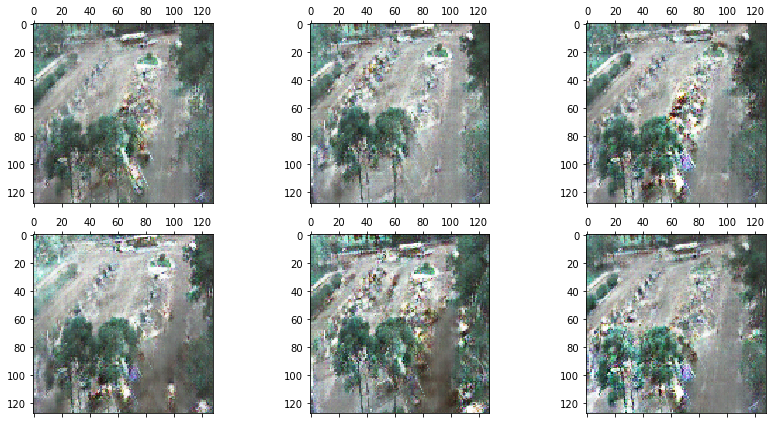

1/1 [==============================] - 5s 5s/step
Epoch number:  600
*** Training ***
Discriminator Loss  0.5770788788795471
Generator Loss:  1.3864872455596924
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6000000238418579
Discriminator Accuracy on FAKE (generated) images:  1.0


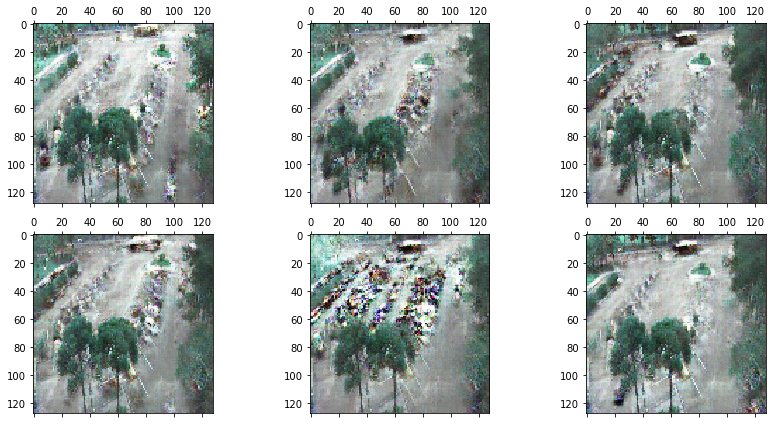

1/1 [==============================] - 5s 5s/step
Epoch number:  700
*** Training ***
Discriminator Loss  0.5801961421966553
Generator Loss:  1.780868649482727
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.3400000035762787
Discriminator Accuracy on FAKE (generated) images:  0.9599999785423279


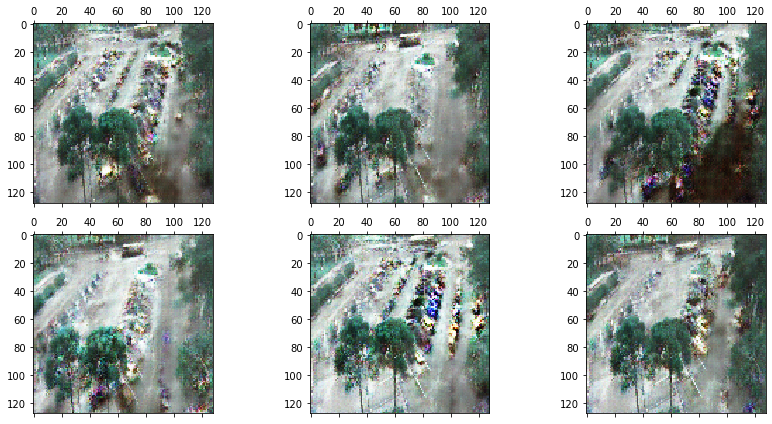

1/1 [==============================] - 5s 5s/step
Epoch number:  800
*** Training ***
Discriminator Loss  0.6728755831718445
Generator Loss:  0.8137266635894775
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8799999952316284
Discriminator Accuracy on FAKE (generated) images:  0.5199999809265137


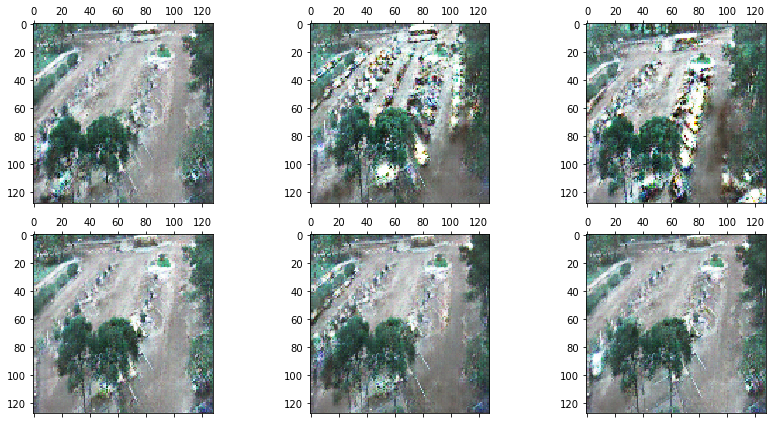

1/1 [==============================] - 5s 5s/step
Epoch number:  900
*** Training ***
Discriminator Loss  0.7356165647506714
Generator Loss:  0.9519427418708801
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5400000214576721
Discriminator Accuracy on FAKE (generated) images:  0.6200000047683716


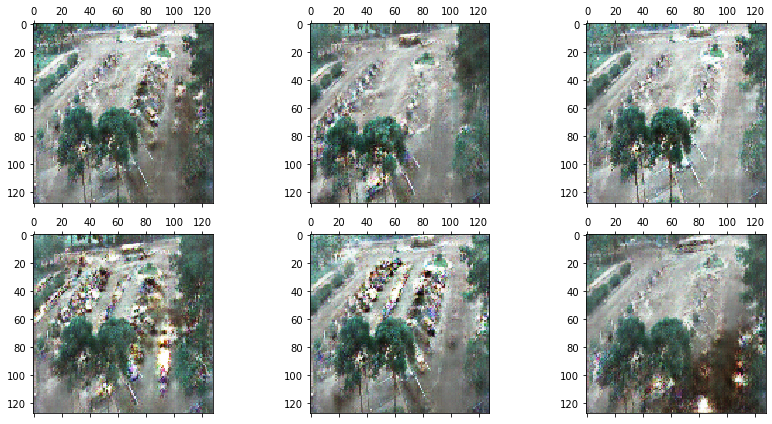

1/1 [==============================] - 5s 5s/step
Epoch number:  1000
*** Training ***
Discriminator Loss  0.7183390259742737
Generator Loss:  1.2599600553512573
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.25999999046325684
Discriminator Accuracy on FAKE (generated) images:  0.9399999976158142


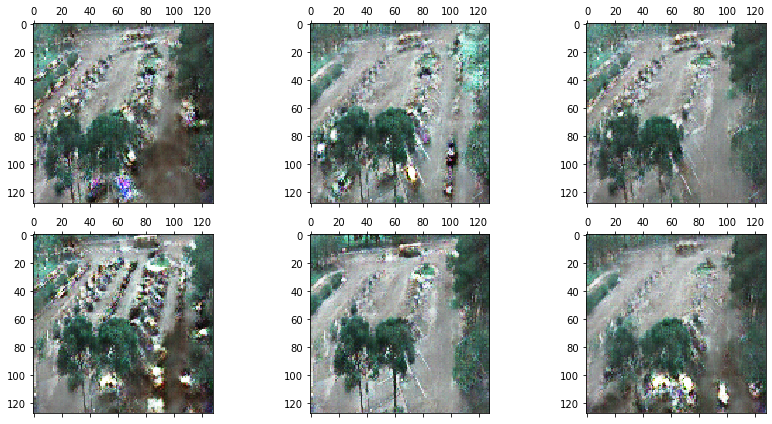

In [42]:
# Continue training model for another 1000 epochs (Total: 3K epochs)
train(gen_model, dis_model, gan_model, data, latent_dim)

1/1 [==============================] - 5s 5s/step
Epoch number:  0
*** Training ***
Discriminator Loss  0.5862621665000916
Generator Loss:  1.0465353727340698
2/2 [==============================] - 15s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8600000143051147
Discriminator Accuracy on FAKE (generated) images:  0.3199999928474426


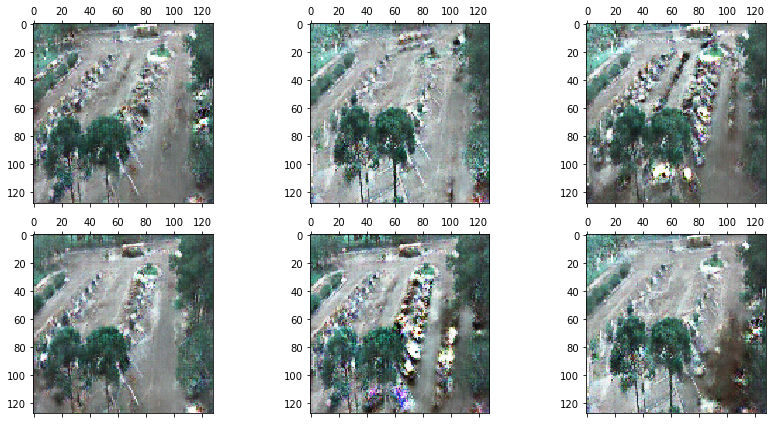

1/1 [==============================] - 5s 5s/step
Epoch number:  100
*** Training ***
Discriminator Loss  0.6558116674423218
Generator Loss:  1.1663432121276855
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5799999833106995
Discriminator Accuracy on FAKE (generated) images:  0.800000011920929


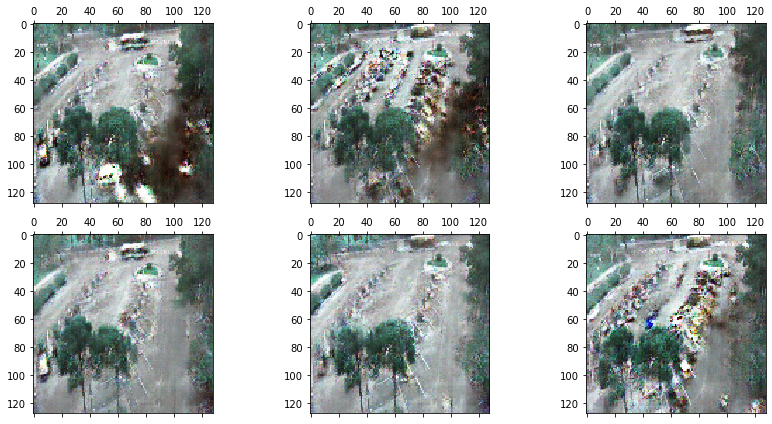

1/1 [==============================] - 5s 5s/step
Epoch number:  200
*** Training ***
Discriminator Loss  0.7508723735809326
Generator Loss:  1.184484839439392
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6200000047683716
Discriminator Accuracy on FAKE (generated) images:  0.6800000071525574


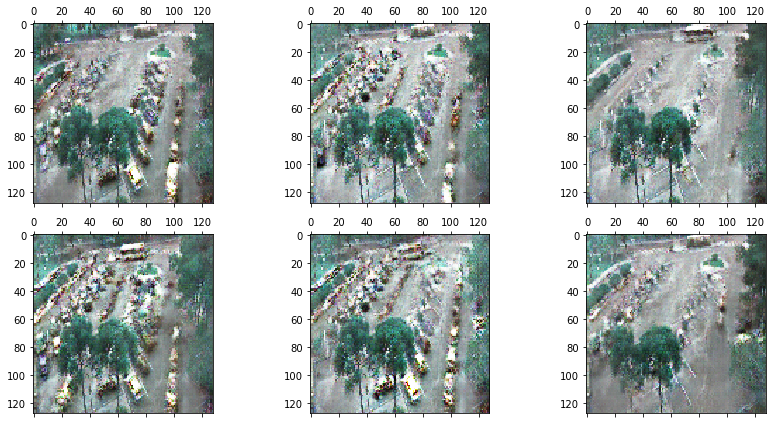

1/1 [==============================] - 5s 5s/step
Epoch number:  300
*** Training ***
Discriminator Loss  0.5913494825363159
Generator Loss:  1.1226389408111572
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5799999833106995
Discriminator Accuracy on FAKE (generated) images:  0.7200000286102295


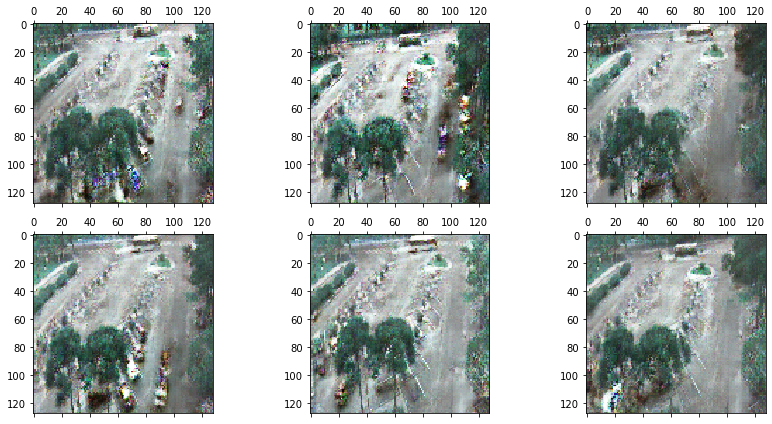

1/1 [==============================] - 5s 5s/step
Epoch number:  400
*** Training ***
Discriminator Loss  0.5576272010803223
Generator Loss:  1.123022437095642
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.699999988079071
Discriminator Accuracy on FAKE (generated) images:  0.7599999904632568


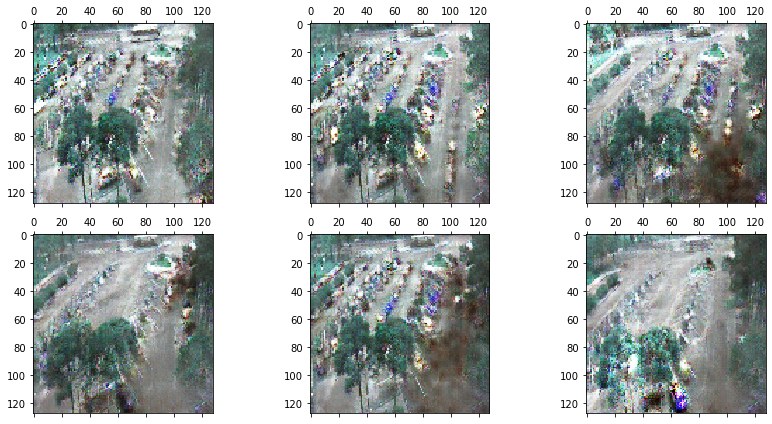

1/1 [==============================] - 5s 5s/step
Epoch number:  500
*** Training ***
Discriminator Loss  0.6351964473724365
Generator Loss:  1.5445950031280518
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.41999998688697815
Discriminator Accuracy on FAKE (generated) images:  1.0


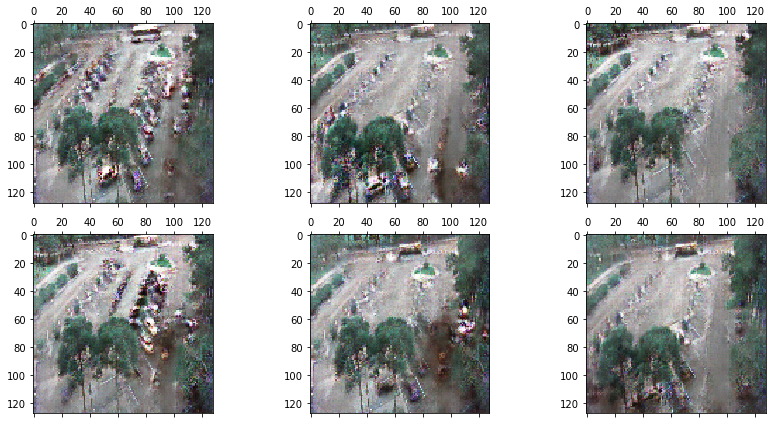

1/1 [==============================] - 6s 6s/step
Epoch number:  600
*** Training ***
Discriminator Loss  0.6124576926231384
Generator Loss:  0.9859692454338074
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5400000214576721
Discriminator Accuracy on FAKE (generated) images:  0.7799999713897705


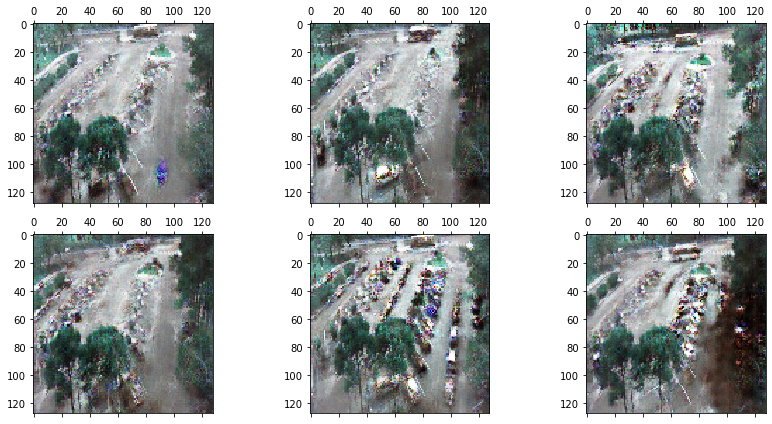

1/1 [==============================] - 5s 5s/step
Epoch number:  700
*** Training ***
Discriminator Loss  0.6317204236984253
Generator Loss:  1.5639137029647827
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.36000001430511475
Discriminator Accuracy on FAKE (generated) images:  1.0


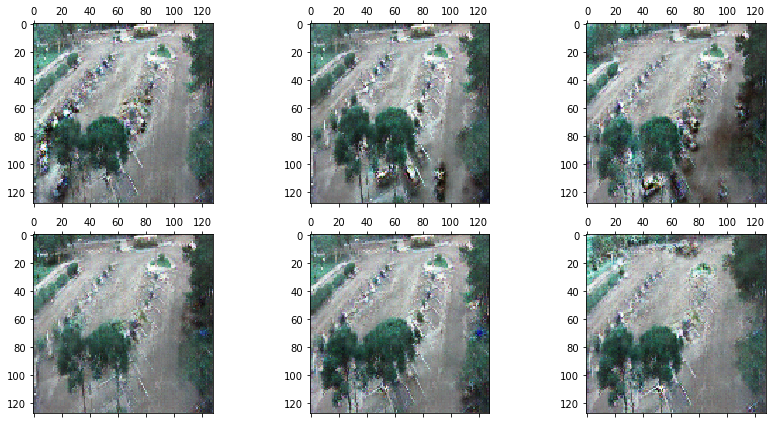

1/1 [==============================] - 5s 5s/step
Epoch number:  800
*** Training ***
Discriminator Loss  0.6414294242858887
Generator Loss:  0.9297372698783875
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5199999809265137
Discriminator Accuracy on FAKE (generated) images:  0.6800000071525574


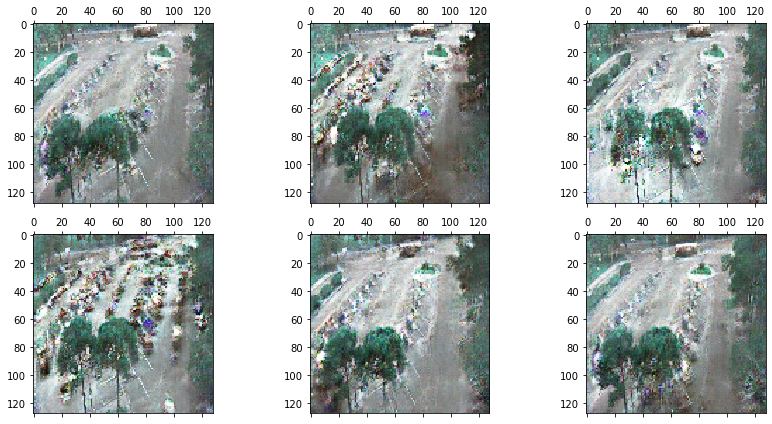

1/1 [==============================] - 5s 5s/step
Epoch number:  900
*** Training ***
Discriminator Loss  0.6228141188621521
Generator Loss:  0.8134151697158813
2/2 [==============================] - 17s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.8799999952316284
Discriminator Accuracy on FAKE (generated) images:  0.41999998688697815


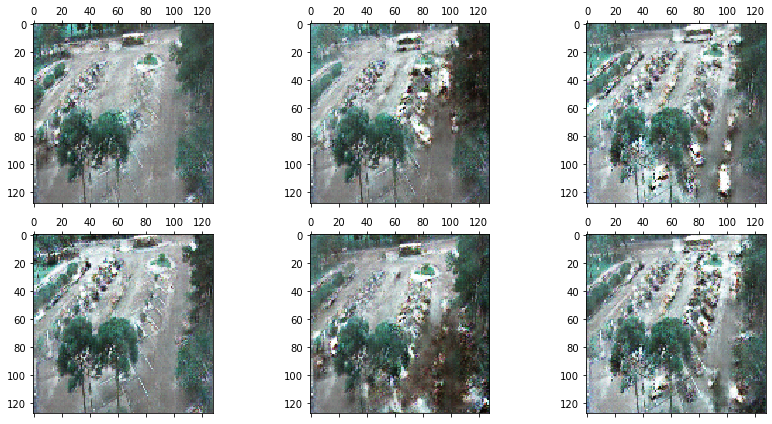

1/1 [==============================] - 5s 5s/step
Epoch number:  1000
*** Training ***
Discriminator Loss  0.6799309849739075
Generator Loss:  1.771788477897644
2/2 [==============================] - 16s 6s/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.3199999928474426
Discriminator Accuracy on FAKE (generated) images:  1.0


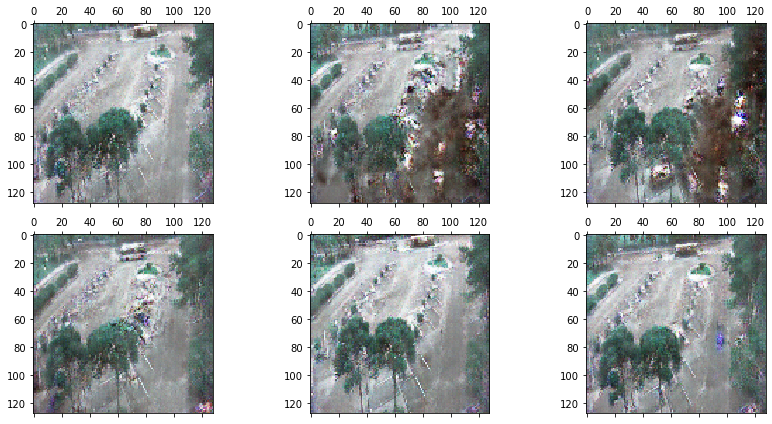

In [43]:
# Continue training model for another 1000 epochs (Total: 4K epochs)
train(gen_model, dis_model, gan_model, data, latent_dim)

In [44]:
# Save the current versions of the models (After 4k epcohs)
gen_model.save(main_dir+"/data/models/007a_Generator_4k.h5")
dis_model.save(main_dir+"/data/models/007a_Discriminator_4k.h5")
gan_model.save(main_dir+"/data/models/007a_GAN_4k.h5")

### Step 7 - Evaluate model performace and use the Generator to create a bunch of images 

In [47]:
def performance_eval(epoch, generator, discriminator, dataset, latent_dim, n=40):
    
    # Get samples of the real data
    x_real, y_real = real_samples(n, dataset)
    # Evaluate the descriminator on real data
    _, real_accuracy = discriminator.evaluate(x_real, y_real, verbose=0)
    
    # Get fake (generated) samples
    x_fake, y_fake = fake_samples(generator, latent_dim, n)
    # Evaluate the descriminator on fake (generated) data
    _, fake_accuracy = discriminator.evaluate(x_fake, y_fake, verbose=0)
    
    # summarize discriminator performance
    print("Epoch number: ", epoch)
    print("Discriminator Accuracy on REAL images: ", real_accuracy)
    print("Discriminator Accuracy on FAKE (generated) images: ", fake_accuracy)
    
    # Create a 2D scatter plot to show real and fake (generated) data points
    # Display 20 fake images
    # Display 6 fake images
    x_fake_inv_trans=x_fake.reshape(-1, 1)
    x_fake_inv_trans=scaler.inverse_transform(x_fake_inv_trans)
    x_fake_inv_trans=x_fake_inv_trans.reshape(n, height, width, length)
    
    fig, axs = plt.subplots(8, 5, sharey=False, tight_layout=True, figsize=(48,48), facecolor='white')
    k=0
    for i in range(0,8):
        for j in range(0,5):
            axs[i,j].matshow(x_fake_inv_trans[k])
            k=k+1
    plt.show() 

# Performance Evaluation using Accuracy method

2/2 [==============================] - 12s 2s/step
Epoch number:  0
Discriminator Accuracy on REAL images:  0.32499998807907104
Discriminator Accuracy on FAKE (generated) images:  1.0


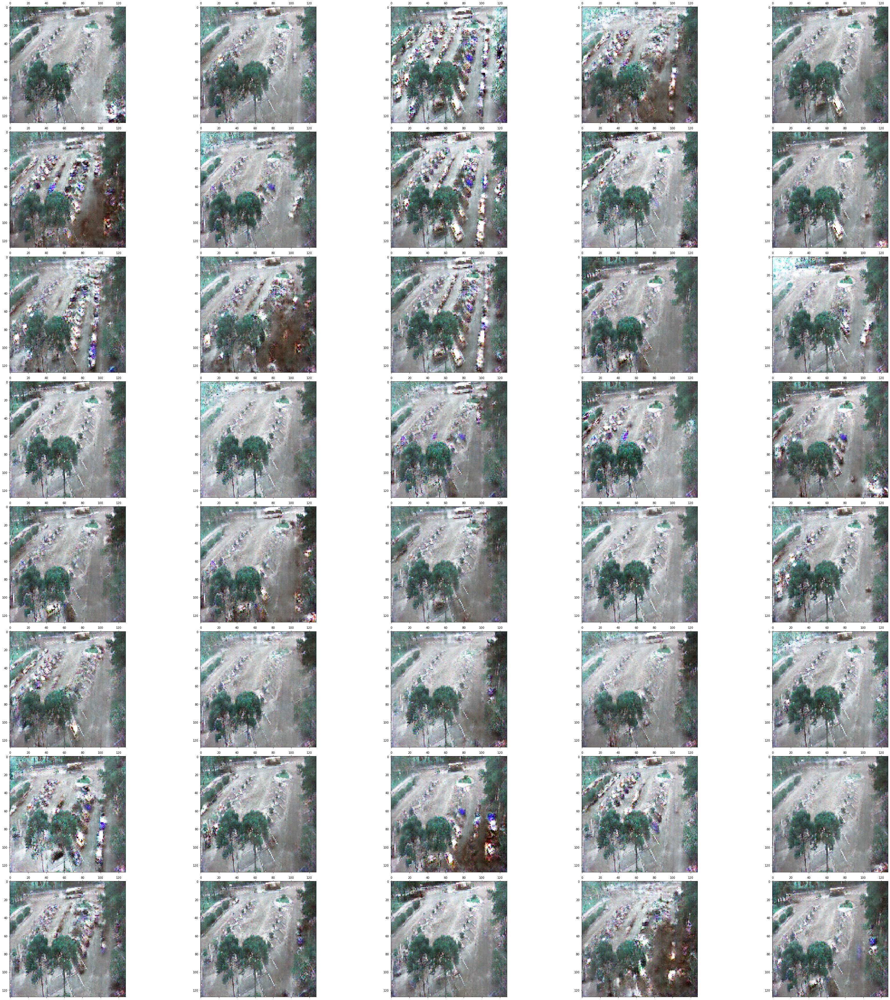

In [48]:
# After 4K epochs
performance_eval(0, gen_model, dis_model, data, 100)

### Appendix - Generate one random Image

In [56]:
# Generate an image of a bonsai tree using random latent vector
x_fake, y_fake = fake_samples(gen_model, 100, 1)

# Shape and inverse transpose the generated image
x_fake_inv_trans=x_fake.reshape(-1, 1)
x_fake_inv_trans=scaler.inverse_transform(x_fake_inv_trans)
x_fake_inv_trans=x_fake_inv_trans.reshape(height, width, length)

1/1 [==============================] - 0s 487ms/step


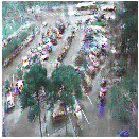

In [57]:
# Show the generated image
fig, ax = plt.subplots(figsize=(16,9), dpi=20)
ax.matshow(x_fake_inv_trans)
plt.axis('off')
plt.show()